# Sampling Rate Conversion

## Introduction and motivation
Different audio systems were invented over the time, and they adopted different sampling rates. Even in one system, users can select multiple different sampling rates according to their needs. Therefore, a sophisticated sampling rate conversion technique is necessary, in order to properly play signals in different settings. As well, some signal processing may benefit from upsampling such as fractional delay or waveshaping.

This lecture was very interesting and meaningful for me as my first audio project was about "audio super-resolution using neural netowork". At the time I had absolutely zero knowledge about signal processing, and I did simple sampling rate conversion; single decimator for downsampling, and single expander for upsampling. The project did not succeed but now I can go and fix my model.



## Audio sampling rates & conversion ratios

- 44.1 kHz
    - Consumer rate
- 48 kHz
    - Professional rate
- 32 kHz
    - Digital radio
- 24 kHz
    - European digital radio 
- 22.05 kHz
    - PC sound effects and PC game sounds
- 11.025 kHz
    - PC sound effects and PC game sounds
- 8 kHz
    - GSM
- 44.1-kHz family 
    - DVD-Audio disks
- 48-kHz family
    - 96 kHz is popular in recording industry


## Basic operations: downsampling & upsampling
- When downsampling, **signal bandwidth is reduced** to avoid aliasing
- When upsampling, **signal bandwidth is not changed**(oversampling)

![decimation](images/decimation.png)

![interpolation](images/interpolation.png)


-----------------
### Upsampling & Downsampling Implementation

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import Audio, display
from scipy.io import wavfile

plt.rcParams['font.size'] = 20
plt.rcParams['axes.labelsize'] = 18   # Time and Hz, i.e. labels
plt.rcParams['axes.labelweight'] = 'bold'
plt.rcParams['xtick.labelsize'] = 18  # Time(x) tick values
plt.rcParams['ytick.labelsize'] = 18  # Hz(y) tick values
plt.rcParams['legend.fontsize'] = 17
plt.rcParams['figure.titlesize'] = 20
plt.rcParams['axes.titlesize'] = 20   # Title font

In [21]:
# Load audio: "Poker face" by Lady Gaga
fs, poker_face_ys = wavfile.read('data/poker_face.wav'); poker_face_ys = poker_face_ys[:,0]
Audio(poker_face_ys[fs*10:fs*40], rate=fs)

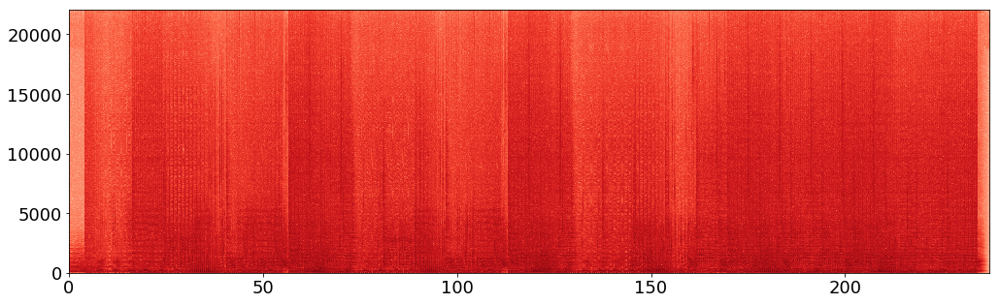

In [7]:
# Spectrogram of source
plt.figure(figsize=(17, 5))
_ = plt.specgram(poker_face_ys, Fs=fs, NFFT=4096, noverlap=3500, cmap="Reds")

In [10]:
# Functions

def plot_spectrogram_column(ys1, ys2, ys3, fs1, fs2, fs3, title):
    f, axarr = plt.subplots(3, sharex=True, sharey=True, figsize=(17, 12))
    # Plot Source
    axarr[0].specgram(ys1, Fs=fs1, NFFT=4096, noverlap=3500, cmap="Reds")
    axarr[0].set_ylabel('Frequencies [Hz]', color='blue')
    axarr[0].set_title(title)
    # Plot Filtered
    axarr[1].specgram(ys2, Fs=fs2, NFFT=4096, noverlap=3500, cmap="Reds")
    axarr[1].set_ylabel('Frequencies [Hz]', color='blue')
    
    axarr[2].specgram(ys3, Fs=fs3, NFFT=4096, noverlap=3500, cmap="Reds")
    axarr[2].set_ylabel('Frequencies [Hz]', color='blue')
    plt.xlabel('Time')

def lowpass(x, N=100):
    # Moving Average
    cumulative_sum = np.cumsum(np.insert(x, 0, 0))
    return (cumulative_sum[N:] - cumulative_sum[:-N]) / N

def downsample(x, fs, factor, N=100):
    y = lowpass(x, N)
    fs = int(fs / factor)
    return fs, y[::factor]

In [22]:
# Let's test our lowpass filter
ys = lowpass(poker_face_ys, 100)
print("Lowpass audio")
display(Audio(ys[fs*10:fs*40], rate=fs))

Lowpass audio


Downsample with different factors: 2, 4, 5 and 10.

Lowpass & Downsample factor 2 audio


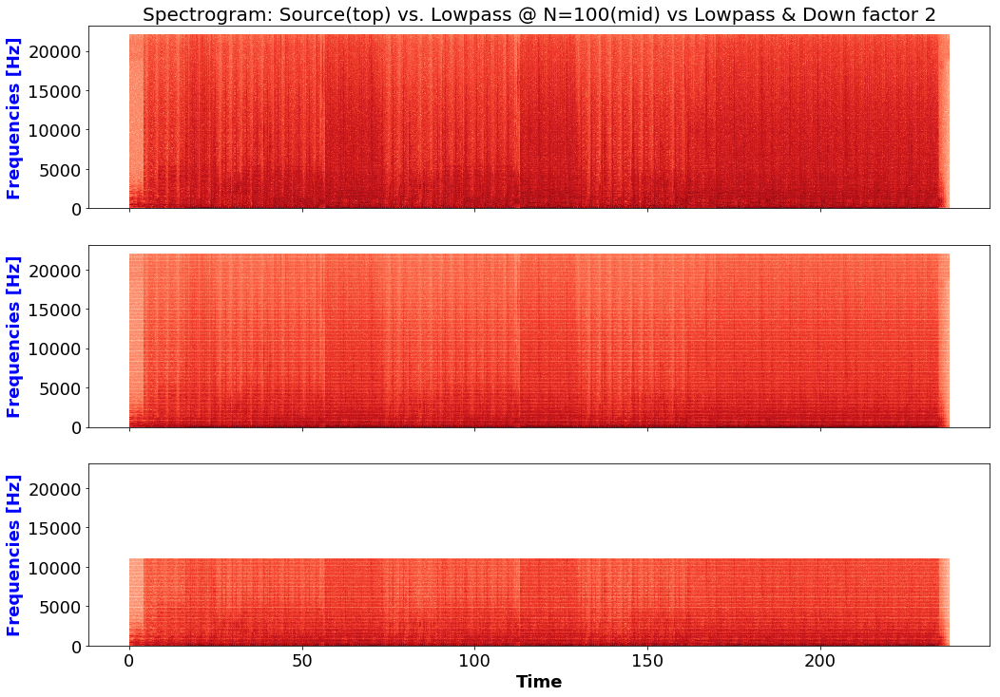

In [18]:
factor = 2
fs_down, ys = downsample(poker_face_ys, fs, factor)
print(f"Lowpass & Downsample factor {factor} audio")
display(Audio(ys, rate=fs_down))

plot_spectrogram_column(poker_face_ys, ys_lowpss, ys, fs, fs, fs_down, 
                        f"Spectrogram: Source(top) vs. Lowpass @ N=100(mid) vs Lowpass & Down factor {factor}")

Lowpass & Downsample factor 4 audio


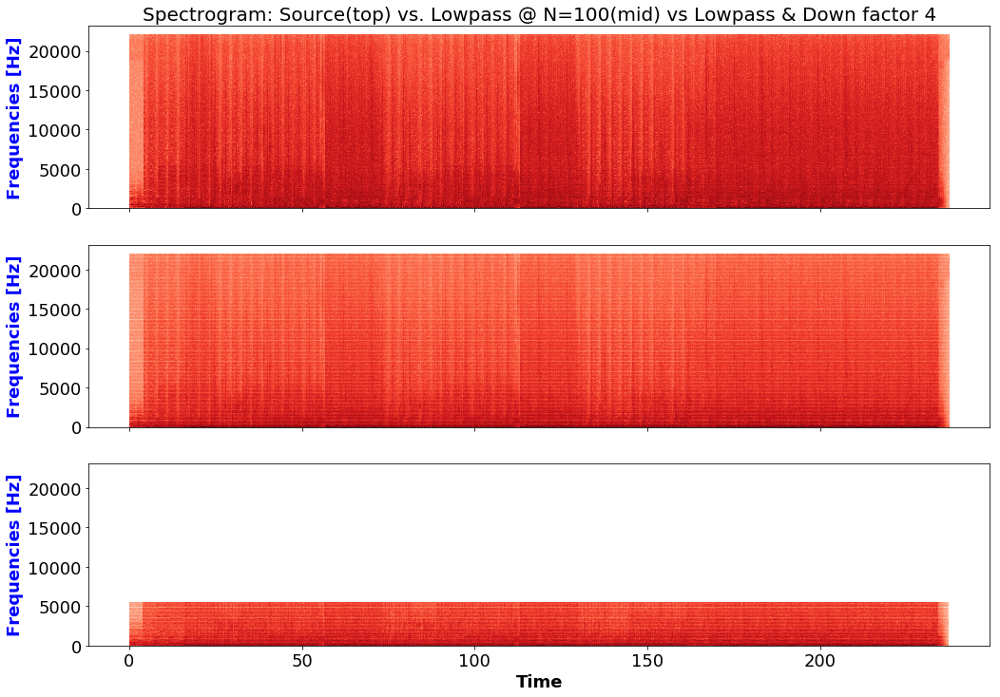

In [14]:
factor = 4
fs_down, ys = downsample(poker_face_ys, fs, factor)
print(f"Lowpass & Downsample factor {factor} audio")
display(Audio(ys, rate=fs_down))

plot_spectrogram_column(poker_face_ys, ys_lowpss, ys, fs, fs, fs_down, 
                        f"Spectrogram: Source(top) vs. Lowpass @ N=100(mid) vs Lowpass & Down factor {factor}")

Lowpass & Downsample factor 5 audio


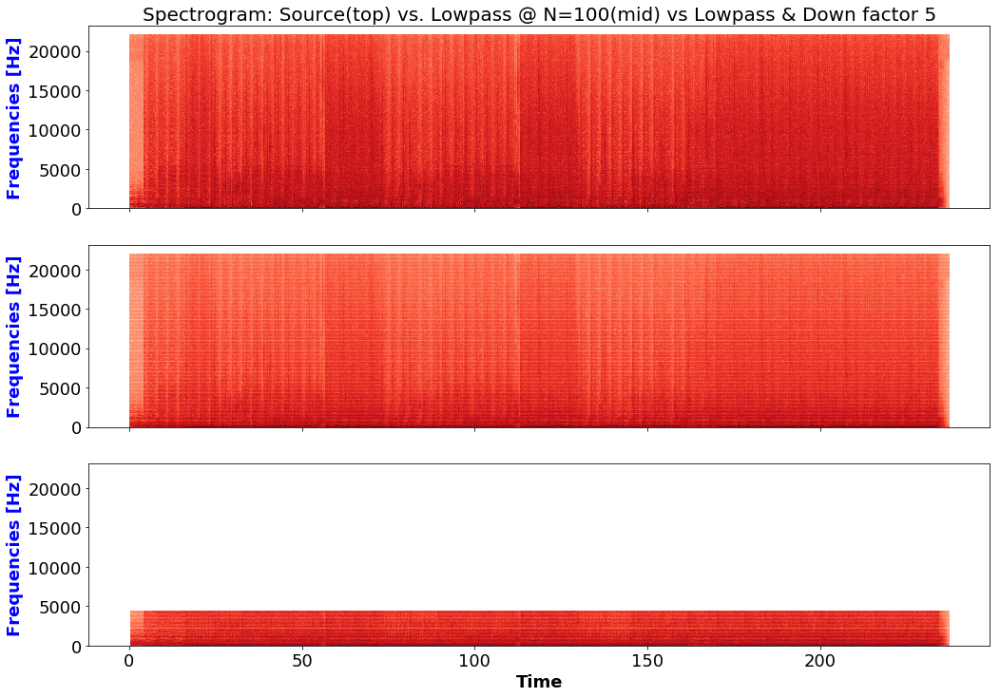

In [15]:
factor = 5
fs_down, ys = downsample(poker_face_ys, fs, factor)
print(f"Lowpass & Downsample factor {factor} audio")
display(Audio(ys, rate=fs_down))

plot_spectrogram_column(poker_face_ys, ys_lowpss, ys, fs, fs, fs_down, 
                        f"Spectrogram: Source(top) vs. Lowpass @ N=100(mid) vs Lowpass & Down factor {factor}")

Lowpass & Downsample factor 10 audio


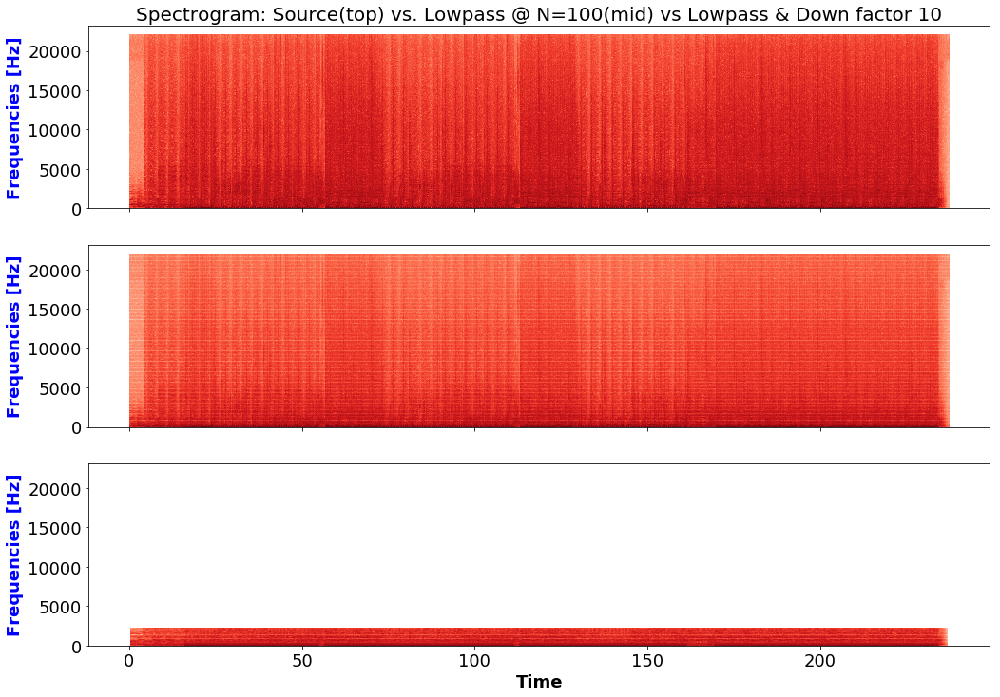

In [16]:
factor = 10
fs_down, ys = downsample(poker_face_ys, fs, factor)
print(f"Lowpass & Downsample factor {factor} audio")
display(Audio(ys, rate=fs_down))

plot_spectrogram_column(poker_face_ys, ys_lowpss, ys, fs, fs, fs_down, 
                        f"Spectrogram: Source(top) vs. Lowpass @ N=100(mid) vs Lowpass & Down factor {factor}")

For comparison, let's listen to downsample output without lowpass filter.

In [20]:
print("Downsample without lowpass filter @ factor 10")
display(Audio(poker_face_ys[::10], rate=fs//10))

Downsample without lowpass filter @ factor 10


## Discussions

We quickly implemented downsampling with lowpass filter. Applying a lowpass filter before downsampling was found to be a crucial step as it removes aliasing effectively. **However, we did not find a way to parameterize a cut-off frequency value for our moving average function in reasonable time.** Further studies are needed to parameterize a cut-off frequency value in order to ensure that aliasing doesn't occur in the downsampling.

## References

- The Scientist and Engineer's guide to digital signal processing